In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer().fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in     vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return vec.vocabulary_.items(), words_freq[:n]


In [ ]:
import pandas as pd
mohler = pd.read_csv("mohler.csv")
mohler.columns

Index(['id', 'question', 'desired_answer', 'student_answer', 'score_me',
       'score_other', 'score_avg'],
      dtype='object')

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
import spacy
nlp = spacy.load("en_core_web_sm")

def text_processing(sentence):
    """
    Lemmatize, lowercase, remove numbers and stop words

    Args:
      sentence: The sentence we want to process.

    Returns:
      A list of processed words
    """
    sentence = [token.lemma_.lower()
                for token in nlp(sentence)
                if token.is_alpha and not token.is_stop]

    return sentence

In [ ]:
mohlercorpus = [str(text_processing(x)) for x in mohler['desired_answer'] + mohler['student_answer']]

In [ ]:
#cars_for_sell = [line.replace("\n", "") for line in open("cars_for_sell.txt")]
vocab, common_words = get_top_n_words(mohlercorpus, 20)
for word, freq in common_words:
    print(word, freq)

function 1490
array 1137
element 1007
list 811
node 628
pointer 486
datum 465
variable 429
member 368
type 357
link 353
call 336
memory 323
tree 322
right 311
store 303
class 299
operation 294
point 266
declare 266


In [ ]:
mohlervocab = dict(vocab).keys()

In [ ]:
len(mohlervocab)

1527

In [ ]:
import pandas as pd
sprag = pd.read_csv("sprag.csv")
sprag.columns

Index(['Unnamed: 0', 'QuestionID', 'ReferenceAnswer', 'StudentAnswer',
       'Score1', 'Score2', 'avg_score', 'max_score'],
      dtype='object')

In [ ]:
spragcorpus = [str(text_processing(str(x))) for x in sprag['ReferenceAnswer'] + sprag['StudentAnswer']]

In [ ]:
#cars_for_sell = [line.replace("\n", "") for line in open("cars_for_sell.txt")]
vocab, common_words = get_top_n_words(spragcorpus, 20)
for word, freq in common_words:
    print(word, freq)
spragvocab = dict(vocab).keys()

value 2245
function 2036
datum 1834
python 1451
list 1314
return 1124
code 1027
give 990
argument 940
method 817
operator 810
variable 764
program 754
object 744
line 739
number 715
call 615
string 546
keyword 546
statement 540


In [ ]:
len(spragvocab)

2056

In [ ]:
!pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 486.2/486.2 kB 15.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 24.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 18.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.8/236.8 kB 27.8 MB/s eta 0:00:00


In [ ]:
# Imports
from datasets import load_dataset
import pandas as pd
import numpy as np
from tqdm import tqdm
tqdm.pandas()

# Load the English STSB dataset
stsb_dataset = load_dataset('stsb_multi_mt', 'en')
stsb_train = pd.DataFrame(stsb_dataset['train'])
stsb_test = pd.DataFrame(stsb_dataset['test'])

# Check loaded data
print(stsb_train.shape, stsb_test.shape)
stsb_test.head()

Generating train split:   0%|          | 0/5749 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/1379 [00:00<?, ? examples/s]

Generating dev split:   0%|          | 0/1500 [00:00<?, ? examples/s]

Dataset stsb_multi_mt downloaded and prepared to /root/.cache/huggingface/datasets/stsb_multi_mt/en/1.0.0/a5d260e4b7aa82d1ab7379523a005a366d9b124c76a5a5cf0c4c5365458b0ba9. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

(5749, 3) (1379, 3)


,sentence1,sentence2,similarity_score
0,A girl is styling her hair.,A girl is brushing her hair.,2.5
1,A group of men play soccer on the beach.,A group of boys are playing soccer on the beach.,3.6
2,One woman is measuring another woman's ankle.,A woman measures another woman's ankle.,5.0
3,A man is cutting up a cucumber.,A man is slicing a cucumber.,4.2
4,A man is playing a harp.,A man is playing a keyboard.,1.5


In [ ]:
strain = [str(text_processing(x)) for x in stsb_train['sentence1'] + stsb_train['sentence2']]
stest = [str(text_processing(x)) for x in stsb_test['sentence1'] + stsb_test['sentence2']]
stsbcorpus = strain + stest

In [ ]:
vocab, common_words = get_top_n_words(stsbcorpus, 20)
for word, freq in common_words:
    print(word, freq)

stsbvocab = dict(vocab).keys()

man 1540
woman 993
dog 739
say 686
play 645
kill 592
white 435
black 391
run 339
people 318
percent 318
stand 284
new 282
girl 275
sit 273
ride 254
boy 251
year 249
state 243
water 226


In [ ]:
len(stsbvocab)

11043

In [ ]:
len(spragvocab), len(mohlervocab), len(stsbvocab)

(2056, 1527, 11043)

In [ ]:
_, common_words = get_top_n_words(spragcorpus, 1527)
spragwords = [x[0] for x in common_words]

In [ ]:
_, common_words = get_top_n_words(mohlercorpus, 1527)
mohlerwords = [x[0] for x in common_words]

In [ ]:
_, common_words = get_top_n_words(stsbcorpus, 1527)
stsbwords = [x[0] for x in common_words]

In [ ]:
len(set(stsbwords).intersection(set(mohlerwords)))

374

In [ ]:
len(set(stsbwords).intersection(set(spragwords)))

344

In [ ]:
len(set(spragwords).intersection(set(mohlerwords)))

661

In [ ]:
import seaborn as sns

In [ ]:
sns.set_theme()
sns.set(rc={"figure.dpi":600, 'savefig.dpi':600})
sns.set_style("white")

Text(0, 0.5, '% of count')

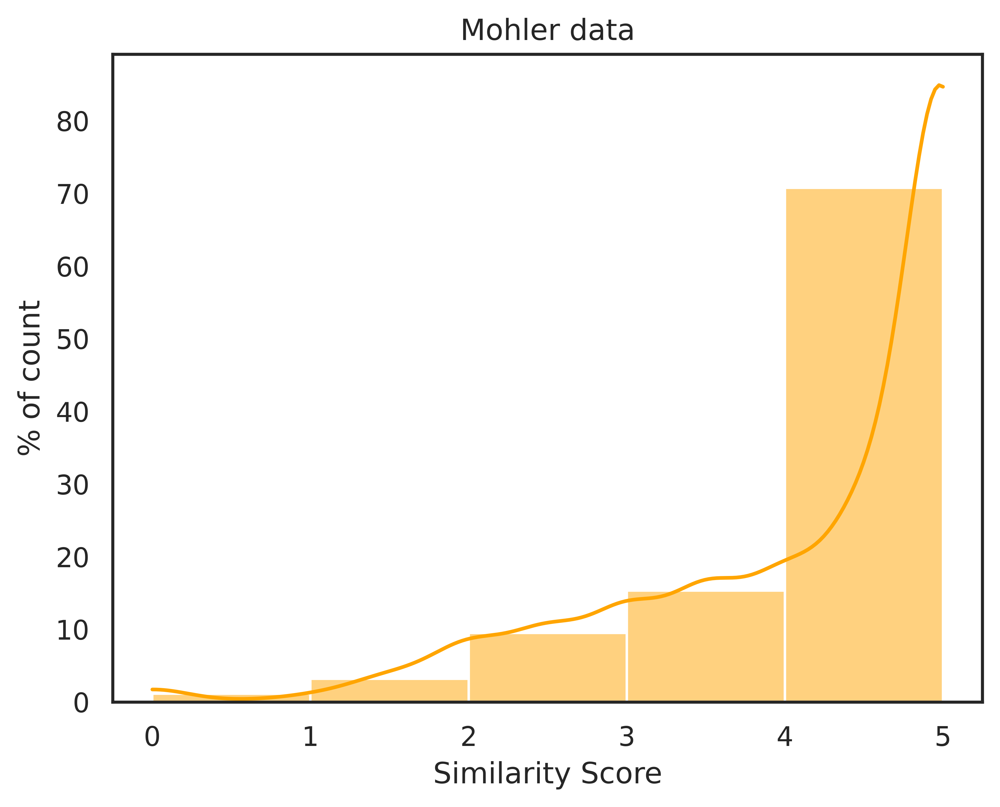

In [ ]:
mohlerhist = sns.histplot(data=mohler, x = 'score_avg', bins=5, stat='percent', color='orange', kde=True)
mohlerhist.set_title("Mohler data")
mohlerhist.set_xlabel("Similarity Score")
mohlerhist.set_ylabel("% of count")

In [ ]:
mohlerhist.get_figure().savefig("mohlerhist.png")

Text(0, 0.5, '% of count')

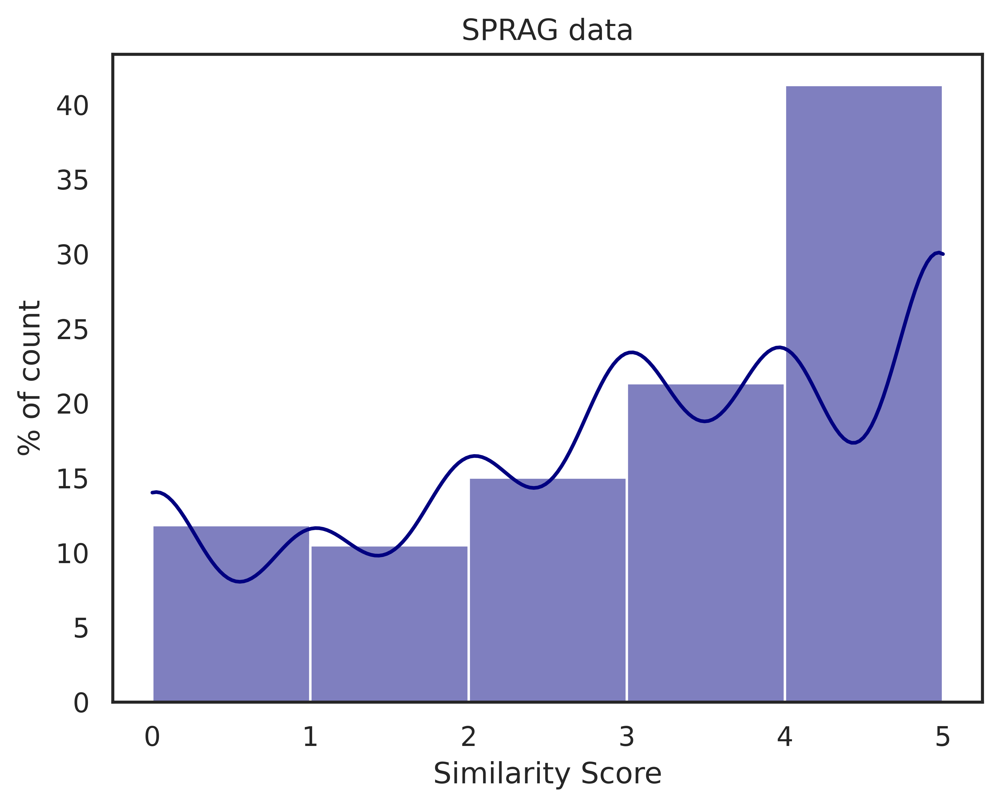

In [ ]:
spraghist = sns.histplot(data=sprag, x = 'avg_score', bins=5, stat='percent', color='navy', kde=True)
spraghist.set_title("SPRAG data")
spraghist.set_xlabel("Similarity Score")
spraghist.set_ylabel("% of count")

In [ ]:
spraghist.get_figure().savefig("spraghist.png")

Text(0, 0.5, '% of count')

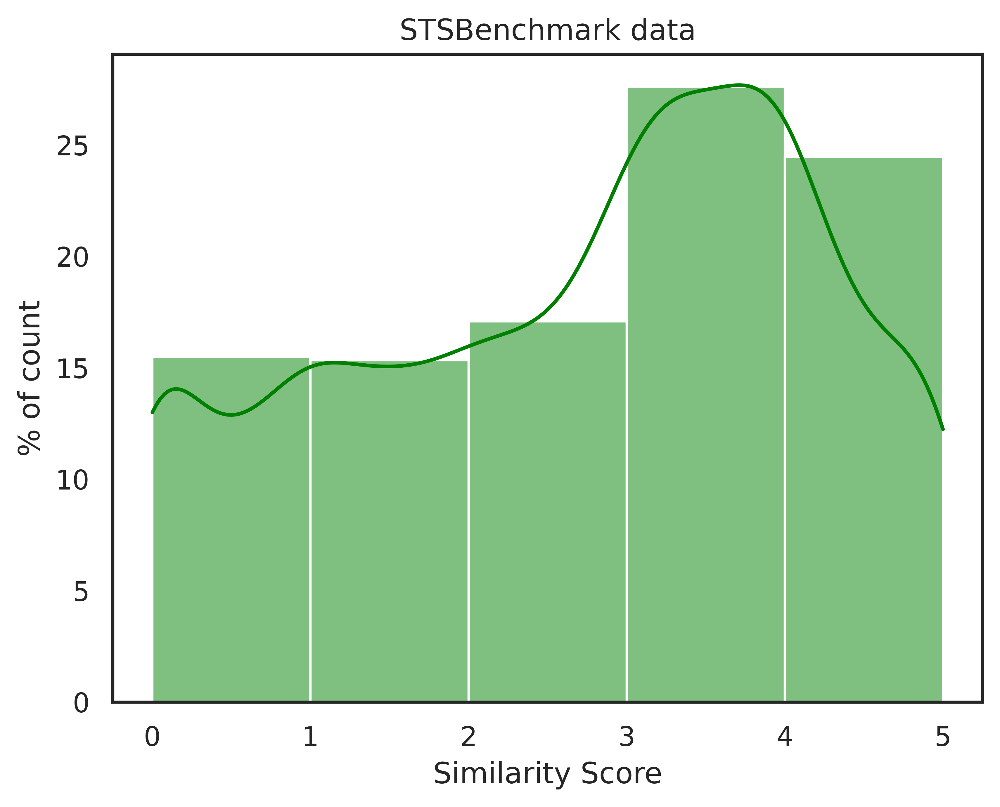

In [ ]:
stsbhist = sns.histplot(data=stsb_train, x = 'similarity_score', bins=5, stat='percent', color='green', kde=True)
stsbhist.set_title("STSBenchmark data")
stsbhist.set_xlabel("Similarity Score")
stsbhist.set_ylabel("% of count")


In [ ]:
stsbhist.get_figure().savefig("stsbhist.png")

In [ ]:
mohler.head()

,id,question,desired_answer,student_answer,score_me,score_other,score_avg
0,1.1,What is the role of a prototype program in pro...,To simulate the behaviour of portions of the d...,High risk problems are address in the prototyp...,4.0,3.0,3.5
1,1.1,What is the role of a prototype program in pro...,To simulate the behaviour of portions of the d...,To simulate portions of the desired final prod...,5.0,5.0,5.0
2,1.1,What is the role of a prototype program in pro...,To simulate the behaviour of portions of the d...,A prototype program simulates the behaviors of...,5.0,3.0,4.0
3,1.1,What is the role of a prototype program in pro...,To simulate the behaviour of portions of the d...,Defined in the Specification phase a prototype...,5.0,5.0,5.0
4,1.1,What is the role of a prototype program in pro...,To simulate the behaviour of portions of the d...,It is used to let the users have a first idea ...,3.0,3.0,3.0


In [ ]:
mohler['s1length'] = mohler['student_answer'].apply(len)
mohler['s2length'] = mohler['desired_answer'].apply(len)
sprag['StudentAnswer'] = sprag['StudentAnswer'].apply(str)
sprag['s1length'] = sprag['StudentAnswer'].apply(len)
sprag['ReferenceAnswer'] = sprag['ReferenceAnswer'].apply(str)
sprag['s2length'] = sprag['ReferenceAnswer'].apply(len)
stsb_train['s1length'] = stsb_train['sentence1'].apply(len)
stsb_train['s2length'] = stsb_train['sentence2'].apply(len)

In [ ]:
mohler.describe()

,id,score_me,score_other,score_avg,s1length,s2length
count,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000
mean,7.134659,3.923449,4.406731,4.165090,106.911131,87.438187
std,3.737034,1.518907,0.942295,1.107382,84.493869,56.638516
min,1.100000,0.000000,0.000000,0.000000,1.000000,4.000000
25%,3.600000,3.000000,4.000000,3.500000,51.000000,41.000000
50%,7.300000,5.000000,5.000000,4.500000,89.000000,72.000000
75%,10.700000,5.000000,5.000000,5.000000,142.000000,139.000000
max,12.900000,5.000000,5.000000,5.000000,956.000000,260.000000


In [ ]:
sprag.describe()

,Unnamed: 0,Score1,Score2,avg_score,max_score,s1length,s2length
count,4039.000000,4039.000000,4037.000000,4012.000000,4012.000000,4067.000000,4067.000000
mean,2019.000000,3.087150,2.937082,3.010469,3.100698,85.241210,157.072043
std,1166.103197,1.637863,1.646694,1.630974,1.637515,76.647728,86.547608
min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
25%,1009.500000,2.000000,2.000000,2.000000,2.000000,37.000000,90.000000
50%,2019.000000,3.000000,3.000000,3.000000,3.000000,67.000000,147.000000
75%,3028.500000,5.000000,4.000000,4.500000,5.000000,111.000000,213.000000
max,4038.000000,5.000000,5.000000,5.000000,5.000000,1647.000000,406.000000


In [ ]:
stsb_train.describe()

,similarity_score,s1length,s2length
count,5749.000000,5749.000000,5749.000000
mean,2.700999,57.708471,57.532614
std,1.464398,35.377754,34.647326
min,0.000000,16.000000,15.000000
25%,1.500000,35.000000,35.000000
50%,3.000000,47.000000,47.000000
75%,3.800000,64.000000,65.000000
max,5.000000,367.000000,311.000000


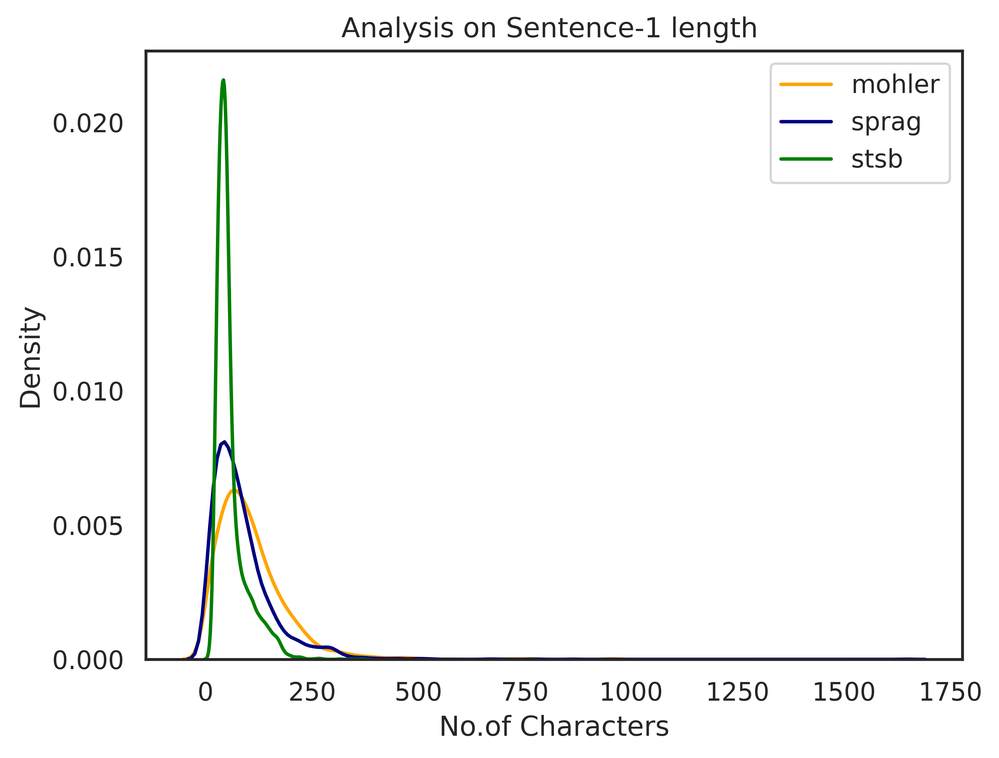

In [ ]:
from matplotlib import pyplot as plt
sns.kdeplot(data=mohler, x='s1length', color = 'orange', label='mohler', legend=True)
sns.kdeplot(data=sprag, x='s1length', color = 'navy', label='Sprag', legend=True)
sns.kdeplot(data=stsb_train, x='s1length', color = 'green', label='stsb', legend=True)
plt.title("Analysis on Sentence-1 length ")
plt.xlabel("No.of Characters")
plt.legend(labels=["mohler","sprag","stsb"])

plt.savefig("sentence1kdeplot.png")
plt.show()

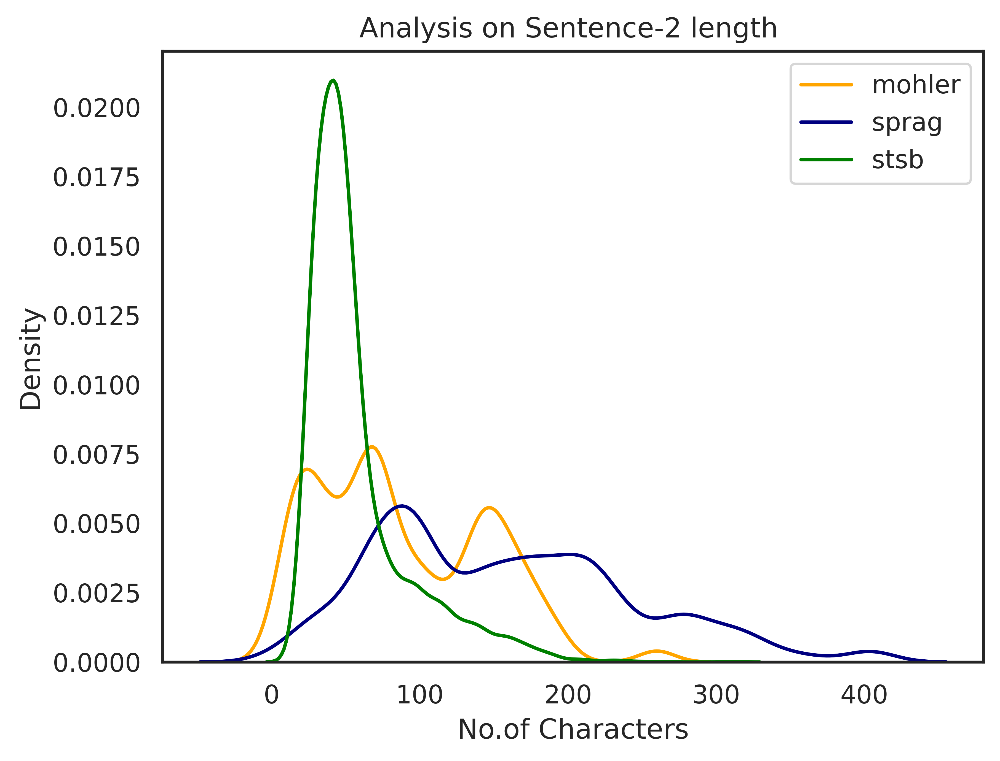

In [ ]:
from matplotlib import pyplot as plt
sns.kdeplot(data=mohler, x='s2length', color = 'orange', label='mohler', legend=True)
sns.kdeplot(data=sprag, x='s2length', color = 'navy', label='Sprag', legend=True)
sns.kdeplot(data=stsb_train, x='s2length', color = 'green', label='stsb', legend=True)
plt.title("Analysis on Sentence-2 length ")
plt.xlabel("No.of Characters")
plt.legend(labels=["mohler","sprag","stsb"])

plt.savefig("sentence2kdeplot.png")
plt.show()

In [ ]:
mohler1 = pd.read_csv("mohlersimilarities.csv")
stsb1 = pd.read_csv("stsbsimilarities.csv")
sprag1 = pd.read_csv("spragsimilarities.csv")
print(mohler1.columns)
print(stsb1.columns)

Index(['Unnamed: 0', 'sentence1', 'sentence2', 'similarity_score',
       'Jaccard_score', 'TFIDF_cosine_score', 'NegWMD_score',
       'USE_cosine_score', 'SBERT CrossEncoder_score',
       'SBERT BiEncoder_cosine_score', 'SimCSE Supervised_cosine_score',
       'SimCSE Unsupervised_cosine_score'],
      dtype='object')
Index(['Unnamed: 0', 'sentence1', 'sentence2', 'similarity_score',
       'Jaccard_score', 'TFIDF_cosine_score', 'NegWMD_score',
       'USE_cosine_score', 'SBERT CrossEncoder_score',
       'SBERT BiEncoder_cosine_score', 'SimCSE Supervised_cosine_score',
       'SimCSE Unsupervised_cosine_score'],
      dtype='object')


In [ ]:
mohler1['similarity_score'] =mohler1['similarity_score']/5.0
stsb1['similarity_score'] =stsb1['similarity_score']/5.0
sprag1['similarity_score'] =sprag1['similarity_score']/5.0

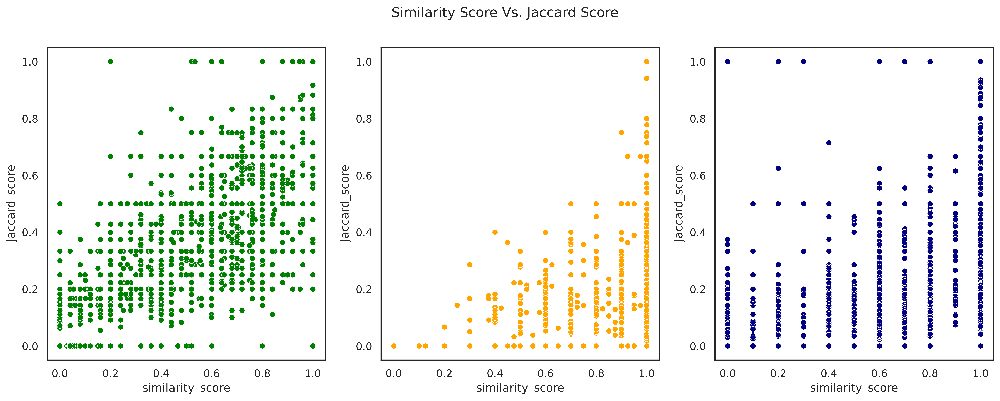

In [ ]:

import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


fig, axes = plt.subplots(1, 3, figsize=(18, 6))

fig.suptitle('Similarity Score Vs. Jaccard Score')

sns.scatterplot(ax=axes[0], data=stsb1, x='similarity_score', y='Jaccard_score',color='green')
sns.scatterplot(ax=axes[1], data=mohler1, x='similarity_score', y='Jaccard_score', color='orange')
sns.scatterplot(ax=axes[2], data=sprag1, x='similarity_score', y='Jaccard_score',color='navy')

plt.savefig("Jaccard.png")

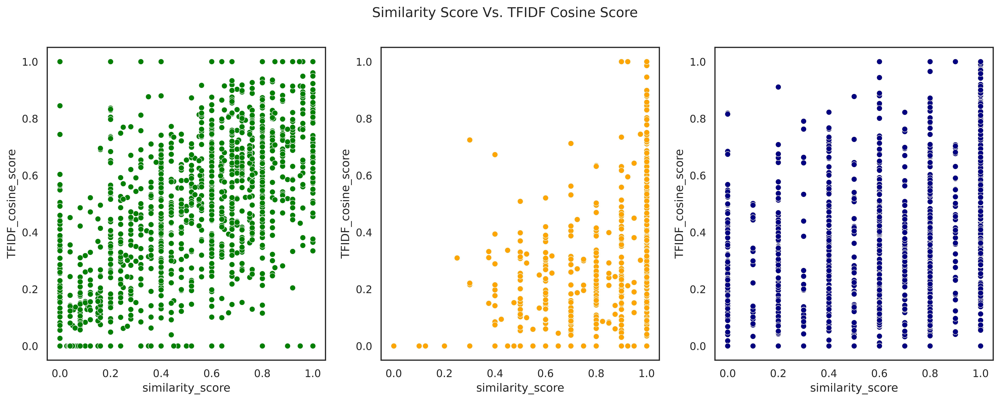

In [ ]:

import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


fig, axes = plt.subplots(1, 3, figsize=(18, 6))

fig.suptitle('Similarity Score Vs. TFIDF Cosine Score')

sns.scatterplot(ax=axes[0], data=stsb1, x='similarity_score', y='TFIDF_cosine_score',color='green')
sns.scatterplot(ax=axes[1], data=mohler1, x='similarity_score', y='TFIDF_cosine_score', color='orange')
sns.scatterplot(ax=axes[2], data=sprag1, x='similarity_score', y='TFIDF_cosine_score',color='navy')

plt.savefig("tfidf.png")

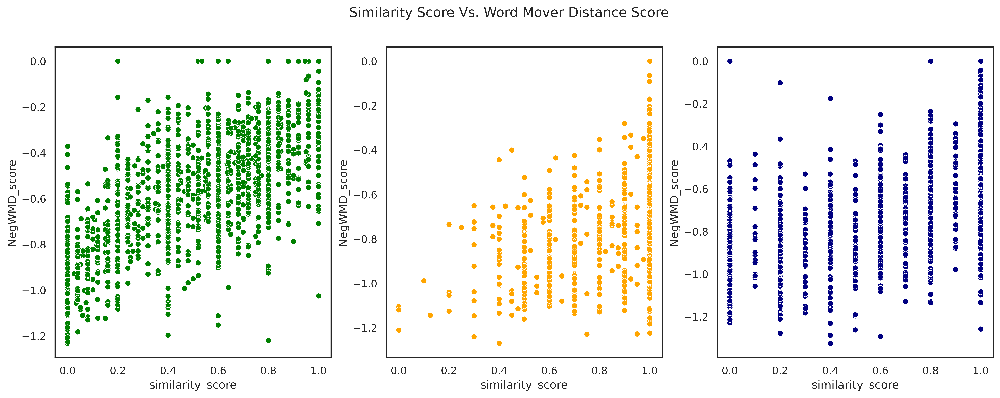

In [ ]:

import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


fig, axes = plt.subplots(1, 3, figsize=(18, 6))

fig.suptitle('Similarity Score Vs. Word Mover Distance Score')

sns.scatterplot(ax=axes[0], data=stsb1, x='similarity_score', y='NegWMD_score',color='green')
sns.scatterplot(ax=axes[1], data=mohler1, x='similarity_score', y='NegWMD_score', color='orange')
sns.scatterplot(ax=axes[2], data=sprag1, x='similarity_score', y='NegWMD_score',color='navy')

plt.savefig("wmd.png")

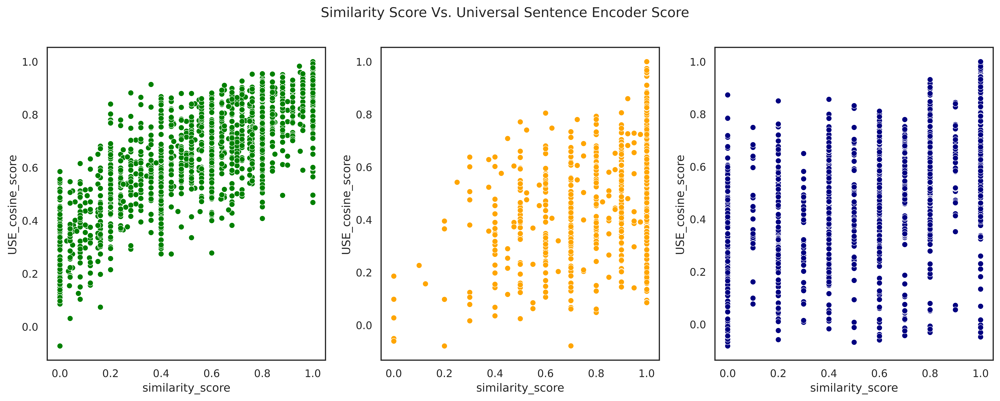

In [ ]:

import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


fig, axes = plt.subplots(1, 3, figsize=(18, 6))

fig.suptitle('Similarity Score Vs. Universal Sentence Encoder Score')

sns.scatterplot(ax=axes[0], data=stsb1, x='similarity_score', y='USE_cosine_score',color='green')
sns.scatterplot(ax=axes[1], data=mohler1, x='similarity_score', y='USE_cosine_score', color='orange')
sns.scatterplot(ax=axes[2], data=sprag1, x='similarity_score', y='USE_cosine_score',color='navy')

plt.savefig("use.png")

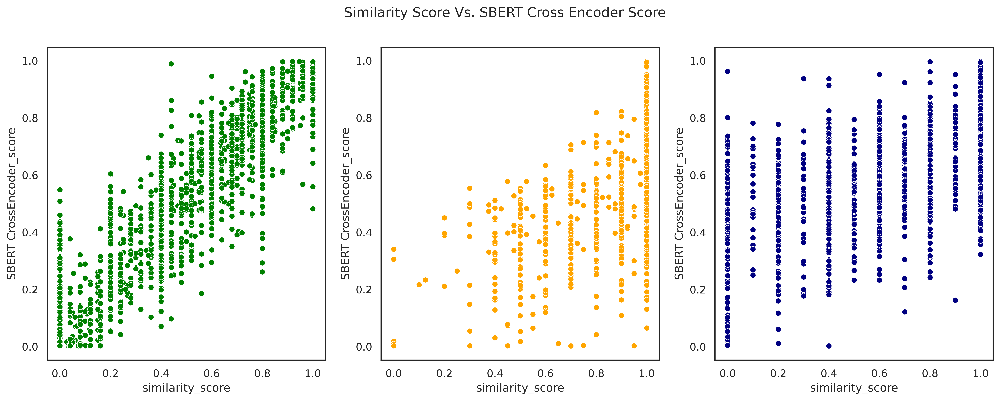

In [ ]:

import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


fig, axes = plt.subplots(1, 3, figsize=(18, 6))

fig.suptitle('Similarity Score Vs. SBERT Cross Encoder Score')

sns.scatterplot(ax=axes[0], data=stsb1, x='similarity_score', y='SBERT CrossEncoder_score',color='green')
sns.scatterplot(ax=axes[1], data=mohler1, x='similarity_score', y='SBERT CrossEncoder_score', color='orange')
sns.scatterplot(ax=axes[2], data=sprag1, x='similarity_score', y='SBERT CrossEncoder_score',color='navy')

plt.savefig("sbertce.png")

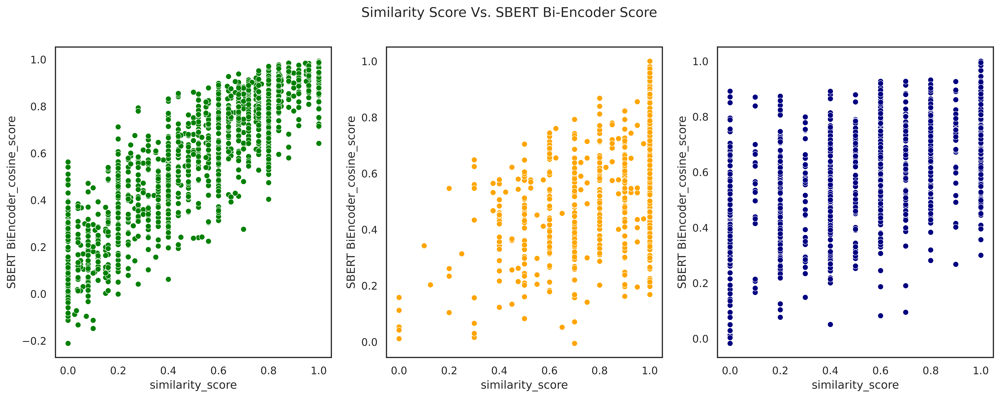

In [ ]:

import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


fig, axes = plt.subplots(1, 3, figsize=(18, 6))

fig.suptitle('Similarity Score Vs. SBERT Bi-Encoder Score')

sns.scatterplot(ax=axes[0], data=stsb1, x='similarity_score', y='SBERT BiEncoder_cosine_score',color='green')
sns.scatterplot(ax=axes[1], data=mohler1, x='similarity_score', y='SBERT BiEncoder_cosine_score', color='orange')
sns.scatterplot(ax=axes[2], data=sprag1, x='similarity_score', y='SBERT BiEncoder_cosine_score',color='navy')

plt.savefig("sbertbie.png")

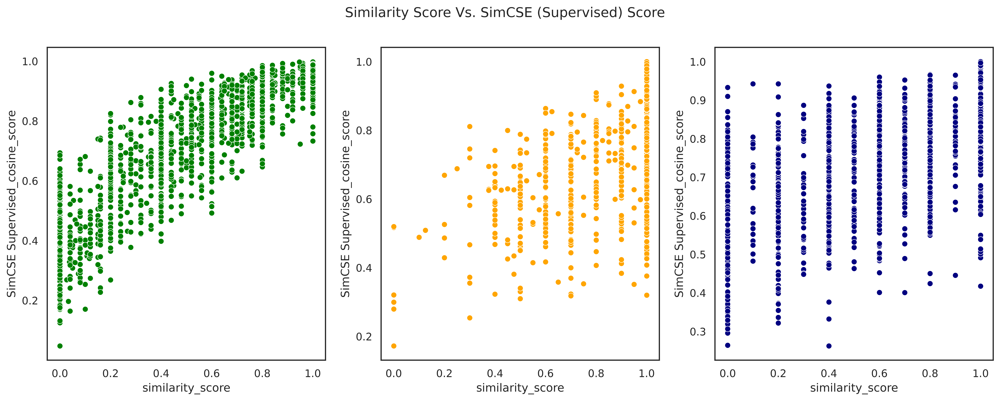

In [ ]:

import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


fig, axes = plt.subplots(1, 3, figsize=(18, 6))

fig.suptitle('Similarity Score Vs. SimCSE (Supervised) Score')

sns.scatterplot(ax=axes[0], data=stsb1, x='similarity_score', y='SimCSE Supervised_cosine_score',color='green')
sns.scatterplot(ax=axes[1], data=mohler1, x='similarity_score', y='SimCSE Supervised_cosine_score', color='orange')
sns.scatterplot(ax=axes[2], data=sprag1, x='similarity_score', y='SimCSE Supervised_cosine_score',color='navy')

plt.savefig("simcsesupervised.png")

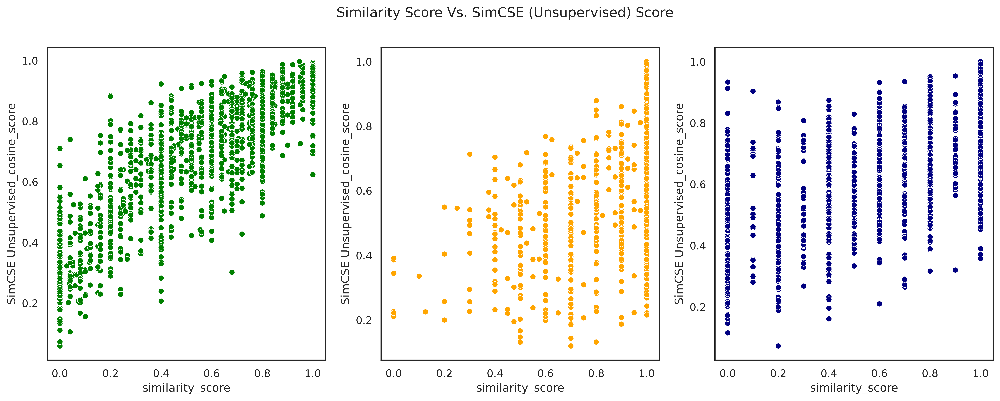

In [ ]:

import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


fig, axes = plt.subplots(1, 3, figsize=(18, 6))

fig.suptitle('Similarity Score Vs. SimCSE (Unsupervised) Score')

sns.scatterplot(ax=axes[0], data=stsb1, x='similarity_score', y='SimCSE Unsupervised_cosine_score',color='green')
sns.scatterplot(ax=axes[1], data=mohler1, x='similarity_score', y='SimCSE Unsupervised_cosine_score', color='orange')
sns.scatterplot(ax=axes[2], data=sprag1, x='similarity_score', y='SimCSE Unsupervised_cosine_score',color='navy')

plt.savefig("simcseunsupervised.png")

In [ ]:
print(mohler1.columns)

Index(['Unnamed: 0', 'sentence1', 'sentence2', 'similarity_score',
       'Jaccard_score', 'TFIDF_cosine_score', 'NegWMD_score',
       'USE_cosine_score', 'SBERT CrossEncoder_score',
       'SBERT BiEncoder_cosine_score', 'SimCSE Supervised_cosine_score',
       'SimCSE Unsupervised_cosine_score'],
      dtype='object')
